In [96]:
#  Load the "autoreload" extension so that code can change
%load_ext autoreload
%reload_ext autoreload
#  always reload modules so that as you change code in src, it gets loaded
%autoreload 2
%matplotlib inline

import sys
sys.path.append('../')
import src
from src.imports import *
from src.gen_functions import *
# import the Dataset object class
from src.features.dataset import Dataset
from src.features.landuse import *
from src.visualization.mapper import *
from src.visualization.vis_data import *

from src.data.fire_data import process_fire_data, add_datetime_fire 
import pyproj

plt.rcParams.update({'font.size': 16})

#set bokeh output
output_notebook()

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


Loading BokehJS ...

In [2]:
map_folder = '../data/world_maps/'
mfire_folder = '../data/fire_map/world_2000-2020/M6_proc/'
vfire_folder = '../data/fire_map/world_2000-2020/V1_proc/'
poll_folder = '../data/poll_map/'
report_folder = '../reports/map/'

# Fire Thailand 2019

In [2]:
# load country boundarys and abbreviation
country_gdf = get_country_gdf()
country_gdf

,OBJECTID,NAME,2-Letter,3-Letter,geometry
0,12,Australia,AU,AUS,"MULTIPOLYGON (((142.27997 -10.26556, 142.21053..."
1,26,Myanmar,MM,MMR,"MULTIPOLYGON (((96.00681 16.38307, 96.06985 16..."
2,34,Brunei,BN,BRN,"MULTIPOLYGON (((114.09508 4.59054, 114.10165 4..."
3,37,Cambodia,KH,KHM,"POLYGON ((105.81644 11.61746, 105.81908 11.594..."
4,42,China,CN,CHN,"MULTIPOLYGON (((85.10332 28.31639, 85.11360 28..."
5,104,Indonesia,ID,IDN,"MULTIPOLYGON (((95.38019 5.83754, 95.38080 5.8..."
6,106,India,IN,IND,"MULTIPOLYGON (((92.26860 23.71944, 92.20305 23..."
7,128,Laos,LA,LAO,"POLYGON ((104.25700 17.88763, 104.23943 17.937..."
8,158,Malaysia,MY,MYS,"MULTIPOLYGON (((116.85693 7.18389, 116.85234 7..."
9,190,Philippines,PH,PHL,"MULTIPOLYGON (((121.51332 19.24916, 121.42137 ..."


In [5]:
filename = map_folder + 'THA.gdb'
# select province level
prov_map = gpd.read_file(filename, driver='FileGDB', layer=2)
prov_map['geometry'].shape
# overide old crs and convert
crs = pyproj.CRS('EPSG:4326')
prov_map['geometry'] = prov_map['geometry'].set_crs(crs, allow_override=True)
prov_map['geometry'] = prov_map['geometry'].to_crs('EPSG:6933')

(77,)

In [18]:
coord_list = []

for s in prov_map['geometry'].to_crs('EPSG:3395'):
    try:
        temp = np.vstack(s.boundary.coords.xy).transpose()[:-1, :]
        coord_list.append(temp )

    except:
        for b in s.boundary:
            temp = np.vstack(b.coords.xy).transpose()[:-1, :]
            coord_list.append(temp)

coord_arr = np.vstack(coord_list)

In [19]:
coord_arr = coord_arr.flatten()
coord_arr = coord_arr.reshape((-1, 2)) 

In [7]:
# pick a center coordinate
dataset = Dataset('Bangkok')
x = dataset.city_info['long_m']
y = dataset.city_info['lat_m']
#stepx = 2E5

stepx = 0.7E6
stepy = stepx

In [21]:
# range bounds supplied in web mercator coordinates
p = figure(x_range=(x-1*stepx,x+1*stepx), y_range=(y-stepy, y+stepy ),
           x_axis_type="mercator", y_axis_type="mercator", plot_width=1000, plot_height=1000)

p.add_tile(get_provider(Vendors.STAMEN_TERRAIN_RETINA))
p.line(coord_arr[:, 0], coord_arr[:, 1], color='black', legend_label='province border')

show(p)

In [43]:
files = glob(mfire_folder + '*.csv')
th_fire_19 = []
start_date = '2019-09-01'
end_date = '2020-05-15'

for file in tqdm(files):
    fire = pd.read_csv(file)
    # if 'country' not in fire:
    # fire = add_countries(fire=fire, filename=file)
    if (fire['acq_date'].str.contains('2019') | fire['acq_date'].str.contains('2020')).sum():
        fire = add_datetime_fire(fire=fire, timezone=dataset.city_info['Time Zone']).set_index('datetime')
        # select only Thailand fires and during 2019 pollution season
        fire = fire.loc[start_date:end_date]
    else:
        fire = pd.DataFrame()
    
    if len(fire) > 0:
        if 'country' not in fire:
            fire = add_countries(df=fire)
        fire = fire[fire['country'] == 'Thailand']
        th_fire_19.append(fire)
    
th_fire_19 = pd.concat(th_fire_19, ignore_index=True)
th_fire_19['distance'] = 0
print(th_fire_19.shape)













  0%|                                                                                                                                | 0/27 [00:00<?, ?it/s]











  4%|████▍                                                                                                                   | 1/27 [00:14<06:13, 14.36s/it]











  7%|████████▉                                                                                                               | 2/27 [00:18<04:40, 11.21s/it]











 11%|█████████████▎                                                                                                          | 3/27 [00:22<03:39,  9.17s/it]











 15%|█████████████████▊                                                                                                      | 4/27 [00:27<02:59,  7.82s/it]











 19%|██████████████████████▏                                                                                                 | 5/27 [00:29<02:17,  6













 63%|██████████████████████████████████████████████████████████████████████████▉                                            | 17/27 [09:02<08:29, 50.96s/it]













 67%|███████████████████████████████████████████████████████████████████████████████▎                                       | 18/27 [09:03<05:25, 36.14s/it]











 70%|███████████████████████████████████████████████████████████████████████████████████▋                                   | 19/27 [09:05<03:25, 25.70s/it]











 74%|████████████████████████████████████████████████████████████████████████████████████████▏                              | 20/27 [09:06<02:09, 18.45s/it]













 78%|███████████████████████████████████████████████████████████████████████████████████████████▊                          | 21/27 [18:14<17:44, 177.37s/it]













 81%|████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 22/27 [18:15<10:21, 124.21s/it]













 85%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 23/27 [23:05<11:36, 174.07s/it]













 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 24/27 [23:06<06:06, 122.02s/it]











 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 25/27 [23:06<02:51, 85.50s/it]











 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 26/27 [23:06<00:59, 59.91s/it]











100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [23:06<00:00, 51.36s/it]

(31643, 18)


In [46]:
th_fire_19 = add_datetime_fire(fire=th_fire_2019, timezone=dataset.city_info['Time Zone']).set_index('datetime')

In [77]:
th_fire_19.to_csv(poll_folder + 'th_fire_2019.csv', index=True)

In [30]:
def locate_province(p, gdf, col='admin1Name_en'):
    """Find a province hosting the hotspot.

    Args:
        p: Point object
        gdf: geopandas dataframe with albel 
    
    Returns: str 
        name of the country 
    """
    try: 
        province = gdf[gdf['geometry'].contains(p)][col].values[0]
    except: 
        province = np.nan
        
    return province

In [89]:
%%time
# add fire landuse 
label_landuse_fire(poll_folder + 'th_fire_2019.csv')













0it [00:00, ?it/s]

C:/Users/Benny/Documents/Fern/aqi_thailand2/data/poll_map/th_fire_2019_label.csv














1it [00:28, 28.54s/it]













2it [01:15, 34.17s/it]













3it [01:41, 31.50s/it]













4it [01:47, 26.94s/it]

Wall time: 1min 47s


In [91]:
# read fires in 2019 seasons
th_fire_19 = pd.read_csv(poll_folder + 'th_fire_2019_label.csv')
th_fire_19['datetime'] = pd.to_datetime(th_fire_19['datetime'])
th_fire_19 = th_fire_19.set_index('datetime')
th_fire_19['count'] = 1

<AxesSubplot:xlabel='datetime'>

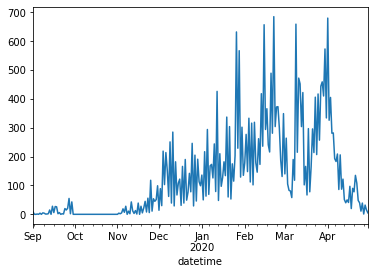

In [55]:
th_fire_19.resample('d').count()['count'].plot()

In [124]:
filename = map_folder + 'THA.gdb'
# select province level
prov_map = gpd.read_file(filename, driver='FileGDB', layer=2)
prov_map['geometry'].shape
# overide old crs and convert
crs = pyproj.CRS('EPSG:4326')
prov_map['geometry'] = prov_map['geometry'].set_crs(crs, allow_override=True)
#prov_map['geometry'] = prov_map['geometry'].to_crs('EPSG:6933')

In [92]:
# add province 
th_fire_19['geometry'] = [Point(x,y) for x, y in zip(th_fire_19['longitude'], th_fire_19['latitude'])]
th_fire_19['province'] = th_fire_19['geometry'].swifter.apply(locate_province, gdf=prov_map, col='admin1Name_en')
th_fire_19 = th_fire_19.drop('geometry', axis=1)
th_fire_19.to_csv(poll_folder + 'th_fire_2019_label.csv', index=True)

In [94]:
# read fires in 2019 seasons
th_fire_19 = pd.read_csv(poll_folder + 'th_fire_2019_label.csv')
th_fire_19['datetime'] = pd.to_datetime(th_fire_19['datetime'])
th_fire_19 = th_fire_19.set_index('datetime')

In [95]:
th_fire_19.head()

,latitude,longitude,distance,long_km,lat_km,LC_Prop2,LC_Prop2_label,LC_Type1,LC_Type1_label,LC_Type5,LC_Type5_label,label,count,province
datetime,,,,,,,,,,,,,,
2019-09-01 13:28:00,14.2963,100.2505,0,11159.834612,1608.232358,25,crop,12,crop,8,crop,crop,1,Suphan Buri
2019-09-01 13:28:00,15.0484,100.8965,0,11231.747003,1694.778698,25,crop,12,crop,8,crop,crop,1,Lop Buri
2019-09-01 13:28:00,14.3446,100.3413,0,11169.942422,1613.781516,25,crop,12,crop,8,crop,crop,1,Phra Nakhon Si Ayutthaya
2019-09-01 13:28:00,14.1411,100.3606,0,11172.090888,1590.409570,25,crop,12,crop,8,crop,crop,1,Phra Nakhon Si Ayutthaya
2019-09-01 13:28:00,14.7607,100.2660,0,11161.560064,1661.637012,25,crop,12,crop,8,crop,crop,1,Ang Thong


In [ ]:
# provinces with most burning 
count_prov = th_fire_19.groupby('province').count()[['count']]
count_prov = count_prov.sort_values('count', ascending=False)

spot_map = prov_map.merge(count_prov.reset_index(), left_on='admin1Name_en', right_on='province', how='left')
spot_map['count'] = spot_map['count'].fillna(0)
spot_map['density'] = spot_map['count']/spot_map['Shape_Area']

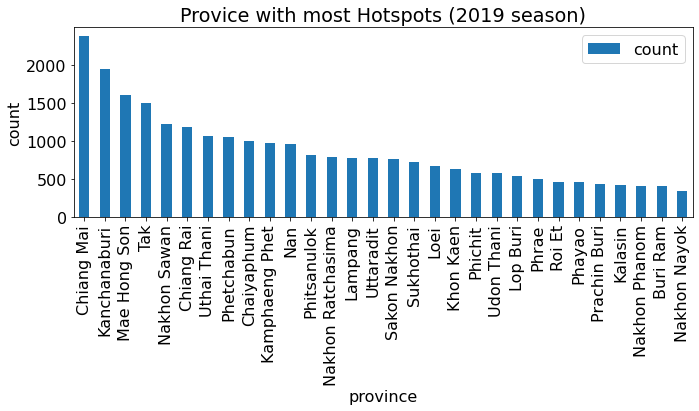

In [167]:
fig, ax = plt.subplots(figsize=(10,6))
count_prov = spot_map.sort_values('count', ascending=False)[['province', 'count']].set_index('province')
count_prov.head(30).plot(kind='bar', ax=ax)
ax.set_title('Provice with most Hotspots (2019 season)')
ax.set_ylabel('count')
plt.tight_layout()

plt.savefig(report_folder + 'th_hotspots_province_bar.png')

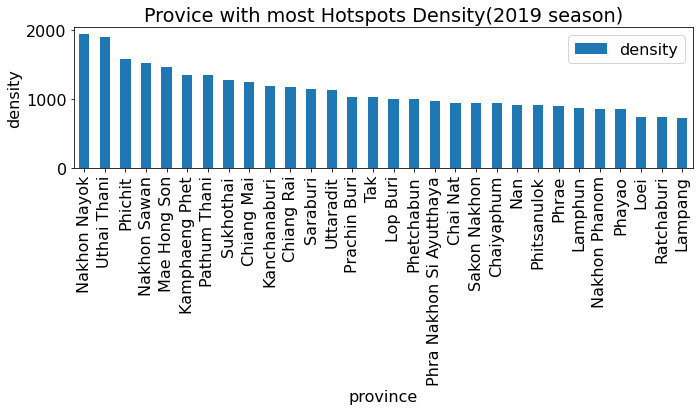

In [166]:
count_prov = spot_map.sort_values('density', ascending=False)[['province', 'density']].set_index('province')

fig, ax = plt.subplots(figsize=(10,6))
count_prov.head(30).plot(kind='bar', ax=ax)
ax.set_title('Provice with most Hotspots Density(2019 season)')
ax.set_ylabel('density')
plt.tight_layout()


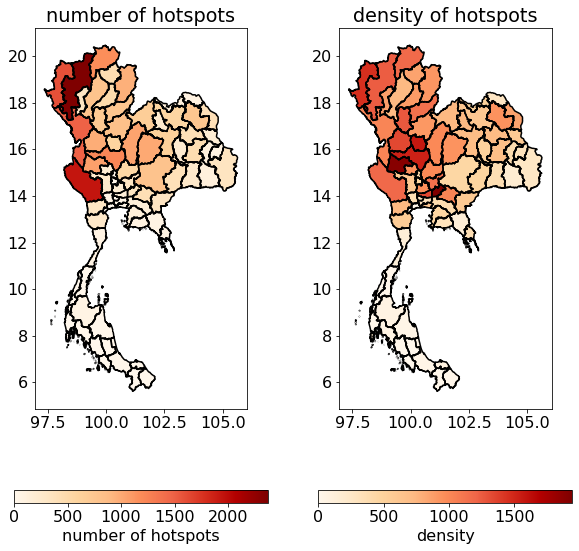

In [160]:
_, ax = plt.subplots(1, 2, figsize=(10,10))
spot_map.plot(column='count',
           ax=ax[0],legend=True,
           legend_kwds={'label': "number of hotspots",
                       'orientation': "horizontal"},  cmap='OrRd')

spot_map.plot(column='density',
           ax=ax[1],legend=True,
           legend_kwds={'label': "density",
                       'orientation': "horizontal"},  cmap='OrRd')

spot_map.boundary.plot(ax=ax[0], color='black')
spot_map.boundary.plot(ax=ax[1], color='black')


ax[0].set_title("number of hotspots")
ax[1].set_title("density of hotspots")

plt.savefig(report_folder + 'th_hotspots_province.png')

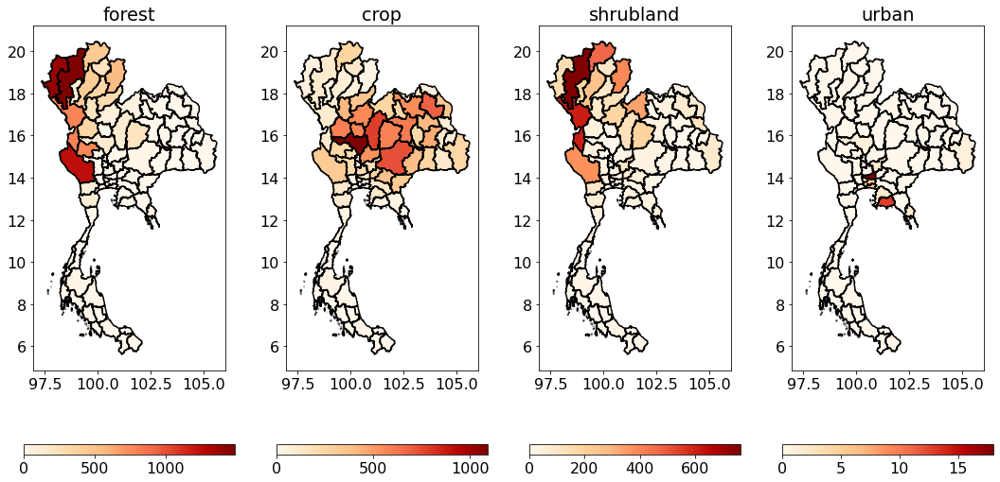

In [150]:
labels = ['forest', 'crop', 'shrubland', 'urban']
fig, ax = plt.subplots(1, len(labels), figsize=(15, 8) )

for label, a in zip(labels, ax):
    temp = th_fire_19[th_fire_19['label']==label]
    temp = temp.groupby('province').count()[['count']]
    
    
    temp = prov_map.merge(temp.reset_index(), left_on='admin1Name_en', right_on='province', how='left')
    temp['count'] = temp['count'].fillna(0)
     
   
    temp.plot(column='count',
           ax=a,legend=True,
           legend_kwds={'orientation': "horizontal"},  cmap='OrRd')
    temp.boundary.plot(ax=a, color='black')

    a.set_title(f"{label}")
    
plt.tight_layout()
plt.savefig(report_folder + 'th_hotspots_province_land.png')

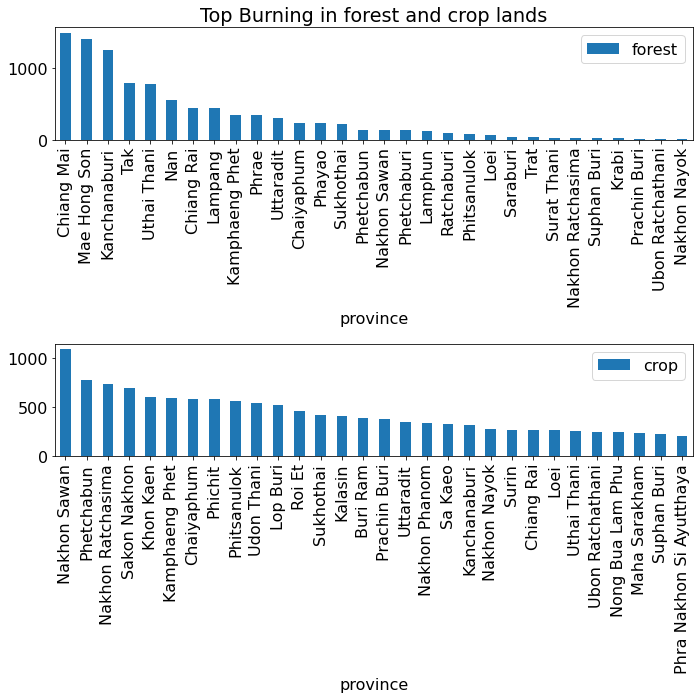

In [148]:
labels = ['forest', 'crop']
fig, ax = plt.subplots(len(labels), 1, figsize=(10, 10))

for label, a in zip(labels, ax):
    temp = th_fire_19[th_fire_19['label']==label]
    temp = temp.groupby('province').count()[['count']]
    
    temp = temp.sort_values('count', ascending=False)
    temp.head(30).plot(kind='bar', ax=a)
    a.legend([label])
    
ax[0].set_title('Top Burning in forest and crop lands')
    
plt.tight_layout()
plt.savefig(report_folder + 'th_hotspots_province_land_bar.png')

# Fire Thailand Build Data

In [32]:
filename = map_folder + 'THA.gdb'
# select province level
prov_map = gpd.read_file(filename, driver='FileGDB', layer=2)
prov_map['geometry'].shape
# overide old crs and convert
crs = pyproj.CRS('EPSG:4326')
prov_map['geometry'] = prov_map['geometry'].set_crs(crs, allow_override=True)

In [19]:
# check columns 
files = glob(mfire_folder + '*.csv')

columns_list = []
for file in files:
    fire = pd.read_csv(file)
    columns_list += fire.columns.to_list()
    
columns_list = list(set(columns_list))
print(columns_list)

['latitude', 'instrument', 'frp', 'acq_date', 'acq_time', 'track', 'bright_t31', 'lat_km', 'satellite', 'daynight', 'type', 'longitude', 'confidence', 'version', 'country', 'long_km', 'scan', 'brightness']


In [34]:
dataset = Dataset('Bangkok')

In [35]:
files = glob(mfire_folder + '*.csv')
#start_date = '2019-09-01'
#end_date = '2020-05-15'

filename = poll_folder + 'tha_fire.csv'
drop_col = ['brightness', 'track', 'scan', 'frp', 'satellite', 'instrument']
country = 'Thailand'

fire_all = []

for file in tqdm(files):
    fire = pd.read_csv(file)
    
    if 'country' not in fire.columns:
        print(file)
        fire = add_countries(df=fire, filename=file)
    
    fire = fire[fire['country'] == country]
    # add province 
    fire['geometry'] = [Point(x,y) for x, y in zip(fire['longitude'], fire['latitude'])]
    fire['province'] = fire['geometry'].swifter.apply(locate_province, gdf=prov_map, col='admin1Name_en')
    fire = fire.drop('geometry', axis=1)
    
    fire = add_datetime_fire(fire=fire, timezone=dataset.city_info['Time Zone']) 
    fire = fire.drop(drop_col, axis=1)
    try:
        fire = fire.drop('type', axis=1)
    except:
        pass
    
    fire_all.append(fire)
    #temp = pd.DataFrame(columns= ['latitude',  'acq_date', 'acq_time', 'bright_t31', 'lat_km', 'daynight', 'longitude', 'confidence', 'version', 'country', 'long_km'])
    #fire = pd.concat([temp, fire], ignore_index=True)
fire_all = pd.concat(fire_all)
fire_all = fire_all.drop_duplicates()
fire_all.to_csv(filename, index=False)






  0%|                                                                                                                                | 0/27 [00:00<?, ?it/s]






  4%|████▎                                                                                                                | 1/27 [08:47<3:48:35, 527.51s/it]






  7%|████████▋                                                                                                            | 2/27 [13:58<3:12:45, 462.62s/it]






 11%|█████████████                                                                                                        | 3/27 [19:20<2:48:09, 420.40s/it]






 15%|█████████████████▎                                                                                                   | 4/27 [24:03<2:25:23, 379.28s/it]






 19%|█████████████████████▋                                                                                               | 5/27 [27:15<1:58:27, 323.08s/it]






 22%|██████████████████████████                                                                                           | 6/27 [32:14<1:50:29, 315.69s/it]






 26%|██████████████████████████████▎                                                                                      | 7/27 [36:20<1:38:18, 294.94s/it]






 30%|██████████████████████████████████▋                                                                                  | 8/27 [40:12<1:27:25, 276.07s/it]






 33%|███████████████████████████████████████                                                                              | 9/27 [46:19<1:30:56, 303.12s/it]






 37%|██████████████████████████████████████████▉                                                                         | 10/27 [50:42<1:22:32, 291.31s/it]






 41%|███████████████████████████████████████████████▎                                                                    | 11/27 [57:52<1:28:43, 332.73s/it]






 44%|██████████████████████████████████████████████████▋                                                               | 12/27 [1:05:36<1:33:04, 372.27s/it]






 48%|██████████████████████████████████████████████████████▉                                                           | 13/27 [1:10:33<1:21:34, 349.61s/it]






 52%|███████████████████████████████████████████████████████████                                                       | 14/27 [1:12:40<1:01:14, 282.69s/it]






 56%|████████████████████████████████████████████████████████████████▍                                                   | 15/27 [1:13:19<41:56, 209.71s/it]






 59%|████████████████████████████████████████████████████████████████████▋                                               | 16/27 [1:13:38<27:55, 152.35s/it]






 63%|█████████████████████████████████████████████████████████████████████████                                           | 17/27 [1:19:11<34:26, 206.63s/it]






 67%|█████████████████████████████████████████████████████████████████████████████▎                                      | 18/27 [1:24:04<34:52, 232.46s/it]






 70%|█████████████████████████████████████████████████████████████████████████████████▋                                  | 19/27 [1:27:14<29:19, 219.97s/it]






 74%|█████████████████████████████████████████████████████████████████████████████████████▉                              | 20/27 [1:30:28<24:43, 211.93s/it]






 78%|██████████████████████████████████████████████████████████████████████████████████████████▏                         | 21/27 [1:34:23<21:53, 218.86s/it]






 81%|██████████████████████████████████████████████████████████████████████████████████████████████▌                     | 22/27 [1:34:23<12:47, 153.47s/it]






 85%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 23/27 [1:35:01<07:55, 118.80s/it]






 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████             | 24/27 [1:35:03<04:11, 83.73s/it]






 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 25/27 [1:35:05<01:58, 59.27s/it]






 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 26/27 [1:35:11<00:43, 43.02s/it]






100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [1:35:24<00:00, 212.03s/it]

In [36]:
filename = poll_folder + 'tha_fire.csv'

# add landuse 
label_landuse_fire(filename)






0it [00:00, ?it/s]

C:/Users/Benny/Documents/Fern/aqi_thailand2/data/poll_map/tha_fire_label.csv







1it [00:26, 26.18s/it]






2it [01:32, 38.23s/it]






3it [02:00, 35.11s/it]






4it [02:25, 32.24s/it]






5it [03:24, 40.11s/it]






6it [03:53, 36.96s/it]






7it [04:19, 33.50s/it]






8it [05:15, 40.36s/it]






9it [06:15, 46.22s/it]






10it [06:41, 40.06s/it]






11it [07:36, 44.70s/it]






12it [08:12, 41.98s/it]






13it [08:55, 42.15s/it]






14it [09:22, 37.87s/it]






15it [09:48, 34.23s/it]






16it [10:45, 40.94s/it]






17it [11:43, 46.26s/it]






18it [12:12, 40.90s/it]






19it [13:09, 45.84s/it]






20it [13:59, 47.07s/it]






21it [14:25, 40.73s/it]






22it [15:21, 45.33s/it]






23it [15:49, 40.12s/it]






24it [16:15, 35.71s/it]






25it [17:13, 42.57s/it]






26it [18:09, 46.67s/it]






27it [18:38, 41.27s/it]






28it [19:03, 36.53s/it]






29it [20:01, 42.91s/it]






30it [20:33, 39.51s/it]






31it [21:00, 35.86s/it]






32it [21:26, 32.87s/it]






33it [21:52, 30.67s/it]






34it [22:34, 34.14s/it]






35it [23:00, 31.67s/it]






36it [23:26, 29.94s/it]






37it [24:23, 38.15s/it]






38it [25:27, 45.77s/it]






39it [25:54, 40.25s/it]






40it [26:27, 38.15s/it]






41it [27:25, 44.03s/it]






42it [28:24, 48.71s/it]






43it [28:53, 42.73s/it]






44it [29:23, 38.79s/it]






45it [29:50, 35.18s/it]






46it [30:16, 32.42s/it]






47it [31:18, 41.36s/it]






48it [31:48, 38.03s/it]






49it [32:14, 34.33s/it]






50it [33:12, 41.58s/it]






51it [33:41, 37.79s/it]






52it [34:19, 37.92s/it]






53it [34:49, 35.29s/it]






54it [35:15, 32.54s/it]






55it [35:44, 31.51s/it]






56it [36:11, 30.14s/it]






57it [36:37, 29.00s/it]






58it [36:40, 37.94s/it]


In [48]:
# merge country, province label with the landuse label
filename = poll_folder + 'tha_fire.csv'

th_fire = pd.read_csv(filename)
th_fire['datetime'] = pd.to_datetime(th_fire['datetime'] )

filename = poll_folder + 'tha_fire_label.csv'

th_fire_label = pd.read_csv(filename)
th_fire_label['datetime'] = pd.to_datetime(th_fire_label['datetime'] )

th_fire_label = th_fire.merge(th_fire_label, on =['latitude','longitude', 'datetime'])

th_fire_label.to_csv(poll_folder + 'tha_fire_label.csv', index=False)

# Fire Thailand all year

In [85]:
filename = poll_folder + 'tha_fire_label.csv'

th_fire_label = pd.read_csv(filename)
th_fire_label['datetime'] = pd.to_datetime(th_fire_label['datetime'] )
th_fire_label['year'] = th_fire_label['datetime'].dt.year
th_fire_label['count'] = 1
th_fire_label = add_season(th_fire_label.set_index('datetime'),  start_month='-09-01', end_month='-05-31')

In [86]:
th_fire_label.head()

,latitude,longitude,label,country,province,year,count,season
datetime,,,,,,,,
2000-11-01 22:54:00,14.1291,101.9528,crop,Thailand,Prachin Buri,2000,1,winter_2000
2000-11-01 22:54:00,14.1158,101.9957,crop,Thailand,Prachin Buri,2000,1,winter_2000
2000-11-02 11:07:00,16.1908,101.9990,shrubland,Thailand,Chaiyaphum,2000,1,winter_2000
2000-11-02 11:07:00,16.9326,103.0034,crop,Thailand,Udon Thani,2000,1,winter_2000
2000-11-02 11:08:00,13.9346,102.3354,crop,Thailand,Sa Kaeo,2000,1,winter_2000


Trend over the year breakdown by landuse

In [92]:
df = th_fire_label.groupby(['year', 'label'], as_index=False).count() 
# drop year 2020
df = df[df['year']< 2020]
df = df[df['year']> 2002]

ValueError: Inputs must not be empty.

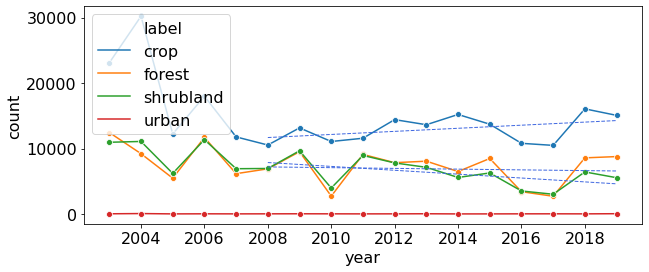

In [98]:
_, ax = plt.subplots(1,1,figsize=(10,4))
sns.lineplot(x='year', y='count', hue='label', data=df, marker='o')

land_list =['crop', 'forest', 'shrubland', 'urband']
for land in land_list:
    temp = df[df['label'] == land].set_index('year')['count']
    temp = temp.loc['2008':]
    add_ln_trend_line(temp, ax, color='royalblue')

ax.xaxis.set_major_locator(MaxNLocator(integer=True))
ax.legend(bbox_to_anchor=(1.05, 1.05), frameon=True)

If I consider shrubland as forest, we will have the crop burning as high as the forest, but I think shrubland is a mix for forest and crop. Seeing that they crop and forest correlated, I still want to separated shrubland as another category.

In [89]:
th_fire_label_combine = th_fire_label.copy()
th_fire_label_combine['label'] = th_fire_label_combine['label'].str.replace('shrubland', 'forest')

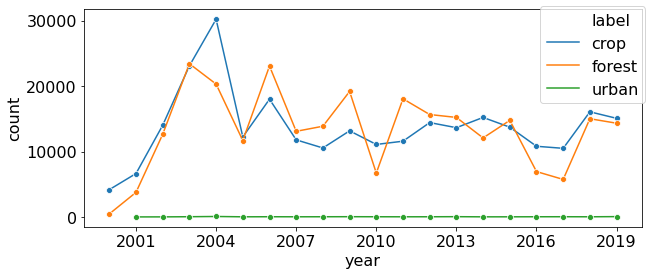

In [91]:
# analysis with shrubland the same as forrest
df = th_fire_label_combine.groupby(['year', 'label'], as_index=False).count() 
df = df[df['year']< 2020]
_, ax = plt.subplots(1,1,figsize=(10,4))
sns.lineplot(x='year', y='count', hue='label', data=df, marker='o')

ax.xaxis.set_major_locator(MaxNLocator(integer=True))
ax.legend(bbox_to_anchor=(1.02, 1.05), frameon=True)

In [ ]:
th_fire_label